<a href="https://colab.research.google.com/github/munikumar229/es335-24-fall-assignment-2/blob/master/Task_5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import torch
import torch.optim as optim
import torchvision
import os
from math import log10, sqrt
from sklearn.metrics import mean_squared_error
from PIL import Image

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [ ]:

# Modify the loss function to ignore NaN values

def factorize(A, k, device=torch.device("cpu")):
    """Factorize the matrix D into A and B"""
    A = A.to(device)
    # Randomly initialize A and B
    W = torch.randn(A.shape[0], k, requires_grad=True, device=device)
    # print(W.shape)
    H = torch.randn(k, A.shape[1], requires_grad=True, device=device)
    # print(H.shape)
    # Optimizer
    optimizer = optim.Adam([W, H], lr=0.01)
    mask = ~torch.isnan(A)
    # Train the model
    for i in range(1000):
        # Compute the loss
        diff_matrix = torch.mm(W, H) - A
        diff_vector = diff_matrix[mask]
        # print(diff_vector)
        loss = torch.norm(diff_vector)
        # print(loss)
        # Zero the gradients
        optimizer.zero_grad()

        # Backpropagate
        loss.backward()

        # Update the parameters
        optimizer.step()

        # if i % 500 == 0:
        #   print(f"{i} ------ {loss.item()}")

    return W, H, loss

dog.jpg exists


In [ ]:
# Read in a image from torchvision



torch.Size([1365, 2048, 3])


In [ ]:

# Make grayscale
# img = torch.tensor(img, dtype=torch.float)
# img = img.mean(dim=0, keepdim=False)
# print(img.shape)

In [ ]:
# img.shape

In [ ]:
# plt.imshow(img)

In [ ]:
def plot_images(p1, p2, i1, i2, i3):
  plt.figure(figsize = (10, 10))

  plt.subplot(3, 2, 1)
  plt.imshow(p1)
  plt.title("Original Patch")

  plt.subplot(3, 2, 2)
  plt.imshow(p2)
  plt.title("Reconstructed Patch")


  plt.subplot(3, 2, 3)
  plt.imshow(i1)
  plt.title("Original image without Patch")


  plt.subplot(3, 2, 4)
  plt.imshow(i2)
  plt.title("Reconstructed Image with Patch")

  plt.subplot(3, 2, 5)
  plt.imshow(i3)
  plt.title("Original Image with Patch")


  plt.subplot(3, 2, 6)
  plt.imshow(i2)
  plt.title("Reconstructed Image with Patch")

In [ ]:
def compute_rmse(og, re):
    # if mask is not None:
    #     # Apply mask to exclude masked regions from RMSE calculation
    #     original = original[mask]
    #     reconstructed = reconstructed[mask]
    mse = np.mean((og - re) ** 2)
    rmse = sqrt(mse)
    return rmse

def compute_psnr(og, re):
    rmse = compute_rmse(og, re)
    if rmse == 0:
        return float('inf')  # Perfect reconstruction
    psnr = 20 * log10(1 / rmse)
    return psnr

In [ ]:
def reconstruct_patch(img, x, y, N, r):

  img1 = img.clone()
  img1 = img1.permute(2, 0, 1)
  patch = torchvision.transforms.functional.crop(img1, x, y, N, N)
  patch = patch.permute(1, 2, 0)
  # print(patch.shape)

  # plt.imshow(patch)

  for i in range(N):
    for j in range(N):
      img[x+i][y+j][0] = float('nan')
      img[x+i][y+j][1] = float('nan')
      img[x+i][y+j][2] = float('nan')

  chan = []
  for i in range(3):
    # print(patch.shape)
    # print(patch[:])
    w, h, _ = factorize(patch[ :, :, i], 10)
    re_chan = torch.mm(w, h).detach()
    # print(re_chan.shape)
    # print(re_chan)
    chan.append(re_chan)
    # chan_ten = torch.tensor(chan)

  re_img = torch.stack(chan, dim=-1)
  # print(re_img.shape)
  # print(re_img)

  # plt.imshow(re_img)

  og_re_img = img.clone()

  for i in range(N):
    for j in range(N):
      og_re_img[x+i][y+j][0] = re_img[i][j][0]
      og_re_img[x+i][y+j][1] = re_img[i][j][1]
      og_re_img[x+i][y+j][2] = re_img[i][j][2]

  img1 = img1.permute(1, 2, 0)
  plot_images(patch, re_img, img, og_re_img, img1)
  print(patch.shape)
  print(f"root mean squared error : {compute_rmse(patch.numpy(), re_img.numpy())}")
  print(f"Peak Signal-to-Noise Ratio : {compute_psnr(patch.numpy(), re_img.numpy())}")

In [ ]:
# Image completion

if os.path.exists('dog.jpg'):
    print('dog.jpg exists')
else:
    !wget https://segment-anything.com/assets/gallery/AdobeStock_94274587_welsh_corgi_pembroke_CD.jpg -O dog.jpg

img = torchvision.io.read_image("dog.jpg").float() / 255.0
img = img.permute(1, 2, 0)
# print(img.shape)

plt.imshow(img)
reconstruct_patch(img, 600, 1000, 50, 10)

In [ ]:
# Open an image file
img = Image.open('dog.jpg')

# Print original size
print(f"Original size: {img.size}")

# Reduce resolution by resizing (e.g., half the original size)
new_width = img.width // 2
new_height = img.height // 2
img_resized = img.resize((new_width, new_height), Image.Resampling.LANCZOS)

# Print new size
print(f"Resized size: {img_resized.size}")

# Save the resized image
img_resized.save('dog1.jpg')

Original size: (2048, 1365)
Resized size: (1024, 682)


In [ ]:
img = torchvision.io.read_image("dog1.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 380, 470, 50, 5)

In [ ]:
img = torchvision.io.read_image("dog1.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 380, 470, 50, 10)

In [ ]:
img = torchvision.io.read_image("dog1.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 380, 470, 50, 25)

In [ ]:
img = torchvision.io.read_image("dog1.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 380, 470, 50, 50)

torch.Size([171, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.07956580226046618
Peak Signal-to-Noise Ratio : 21.98547107761355


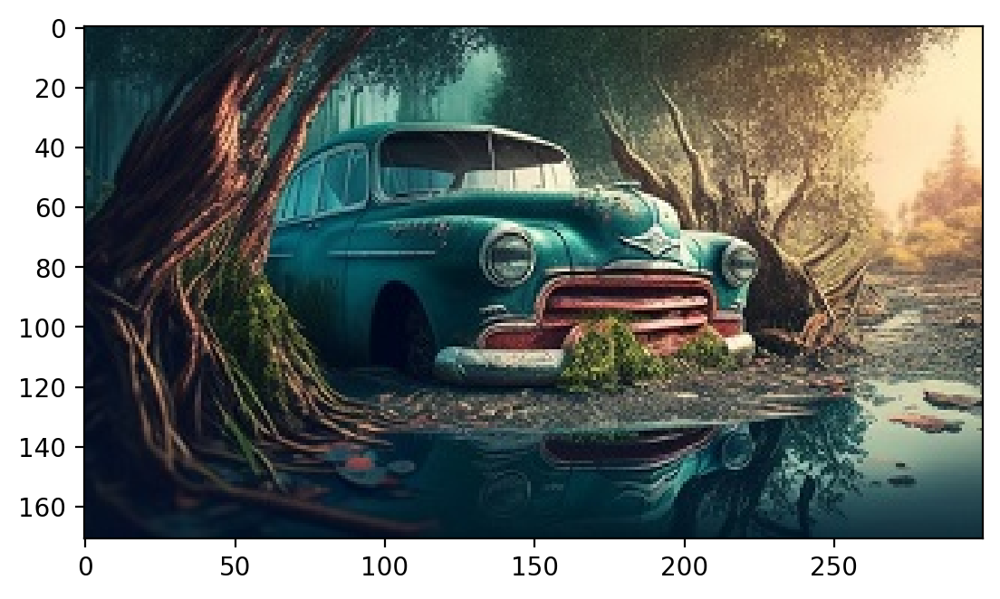

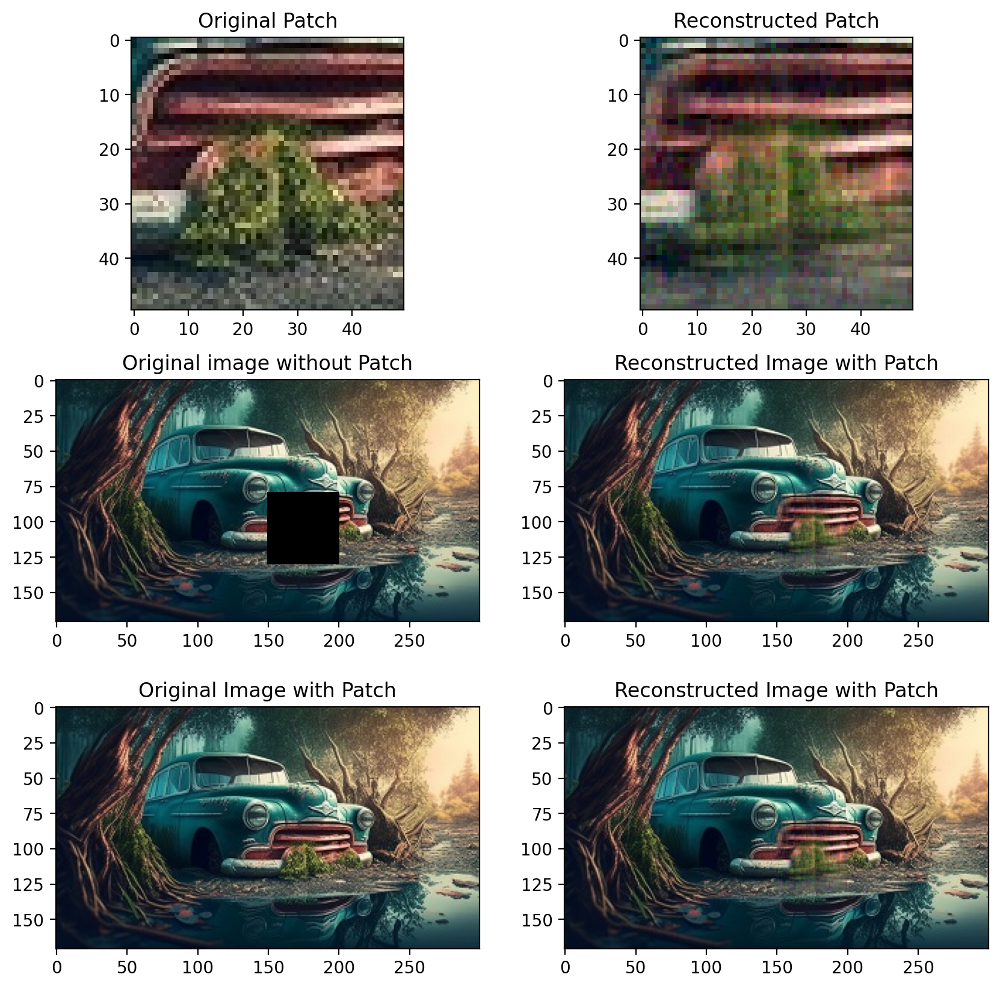

In [ ]:
img = torchvision.io.read_image("car.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 80, 150, 50, 5)

torch.Size([171, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.08036677162349828
Peak Signal-to-Noise Ratio : 21.898469543299658


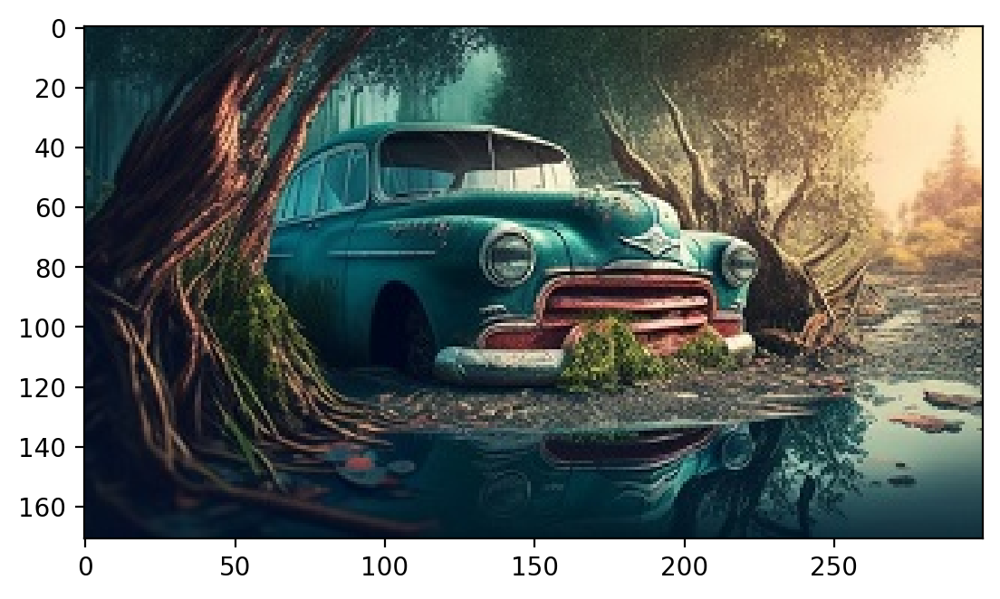

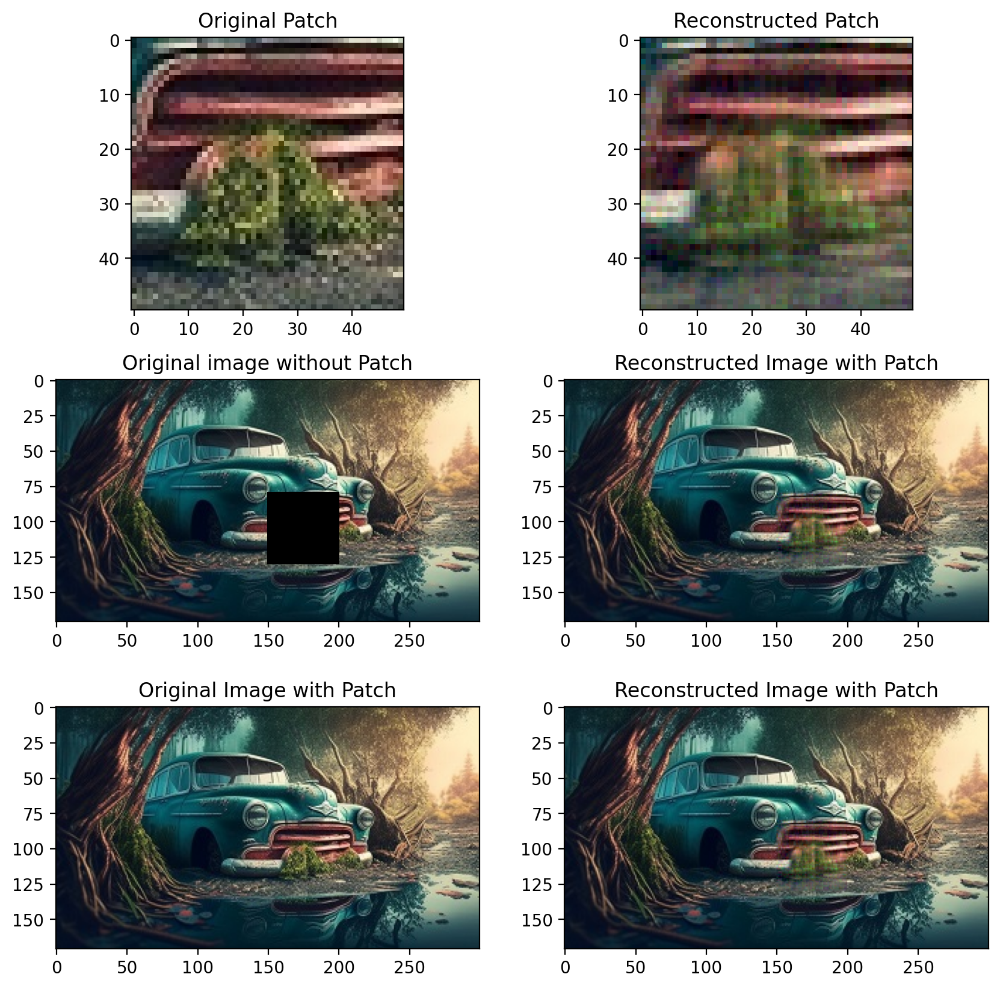

In [ ]:
img = torchvision.io.read_image("car.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 80, 150, 50, 10)

torch.Size([171, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.07937309379241142
Peak Signal-to-Noise Ratio : 22.006533830000063


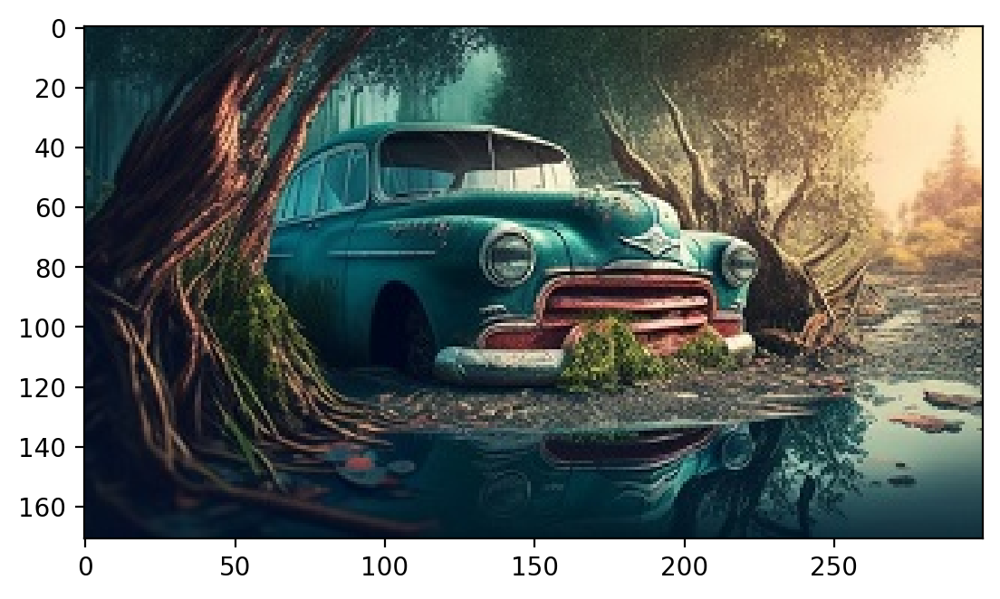

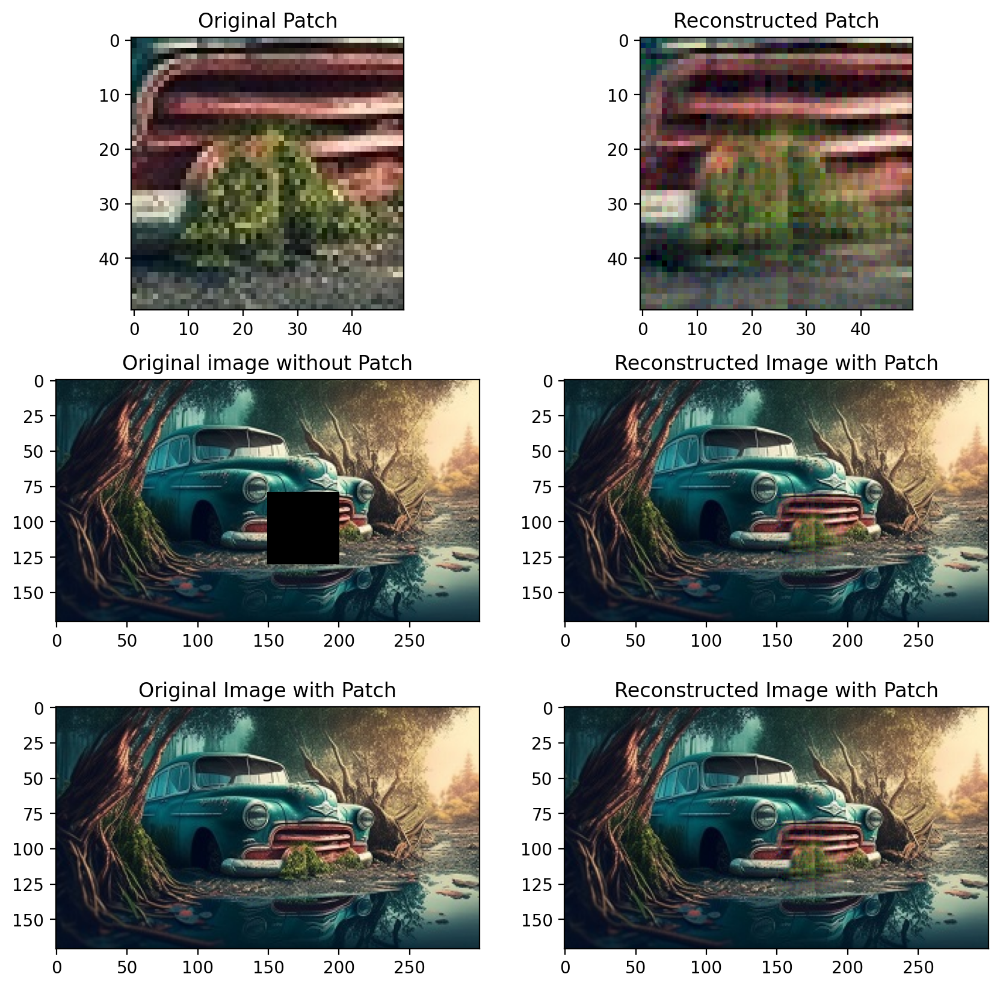

In [ ]:
img = torchvision.io.read_image("car.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 80, 150, 50, 25)

torch.Size([171, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.07858916913934716
Peak Signal-to-Noise Ratio : 22.09274605303618


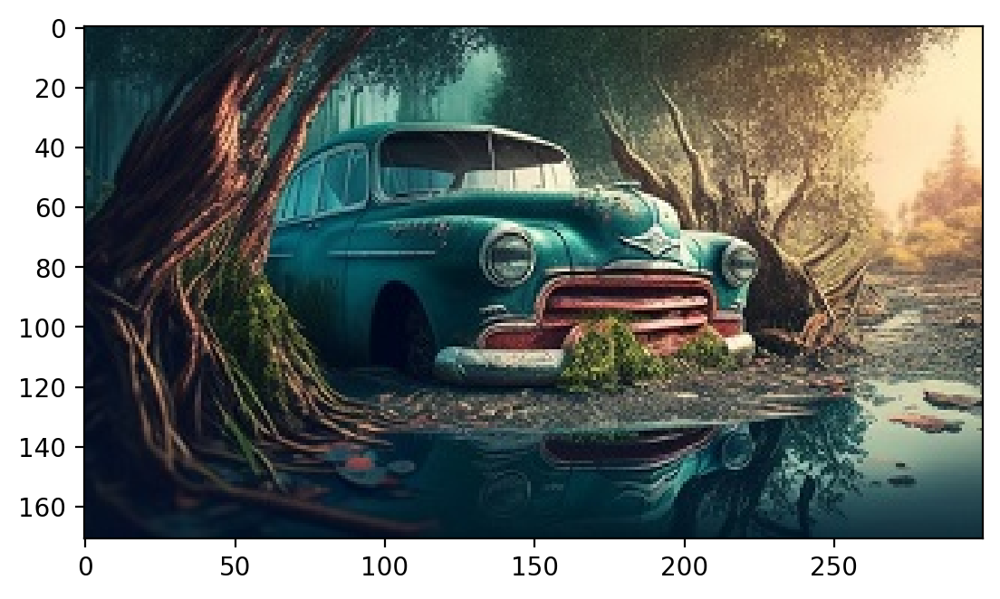

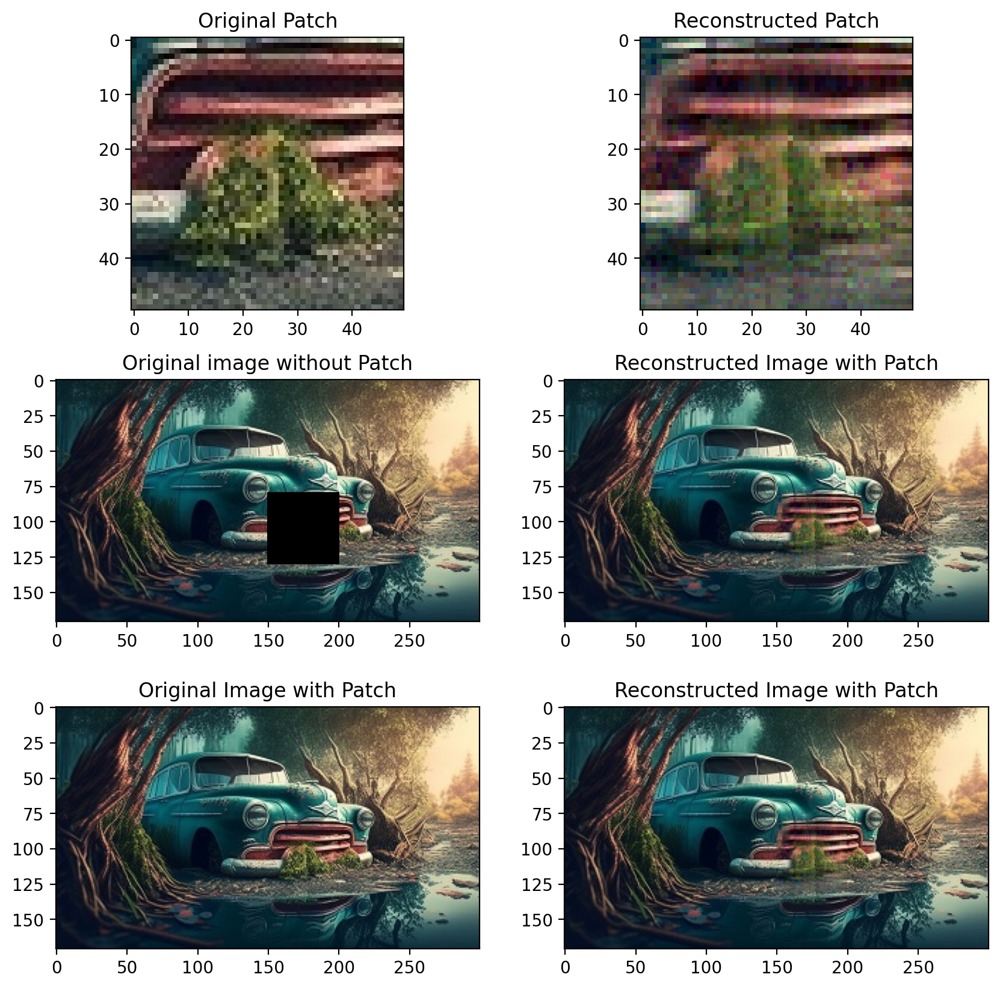

In [ ]:
img = torchvision.io.read_image("car.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 80, 150, 50, 50)

torch.Size([149, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.035230311888465995
Peak Signal-to-Noise Ratio : 29.06167024120616


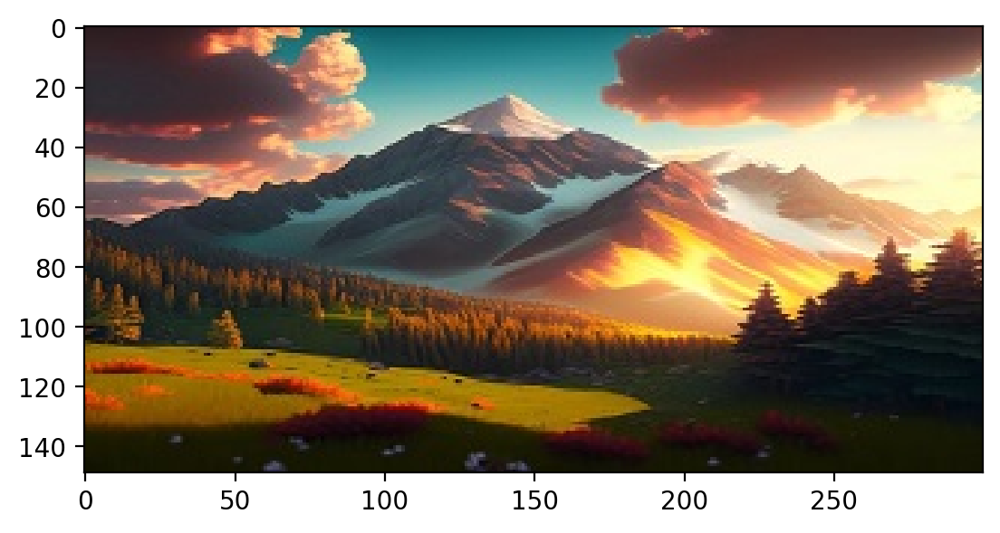

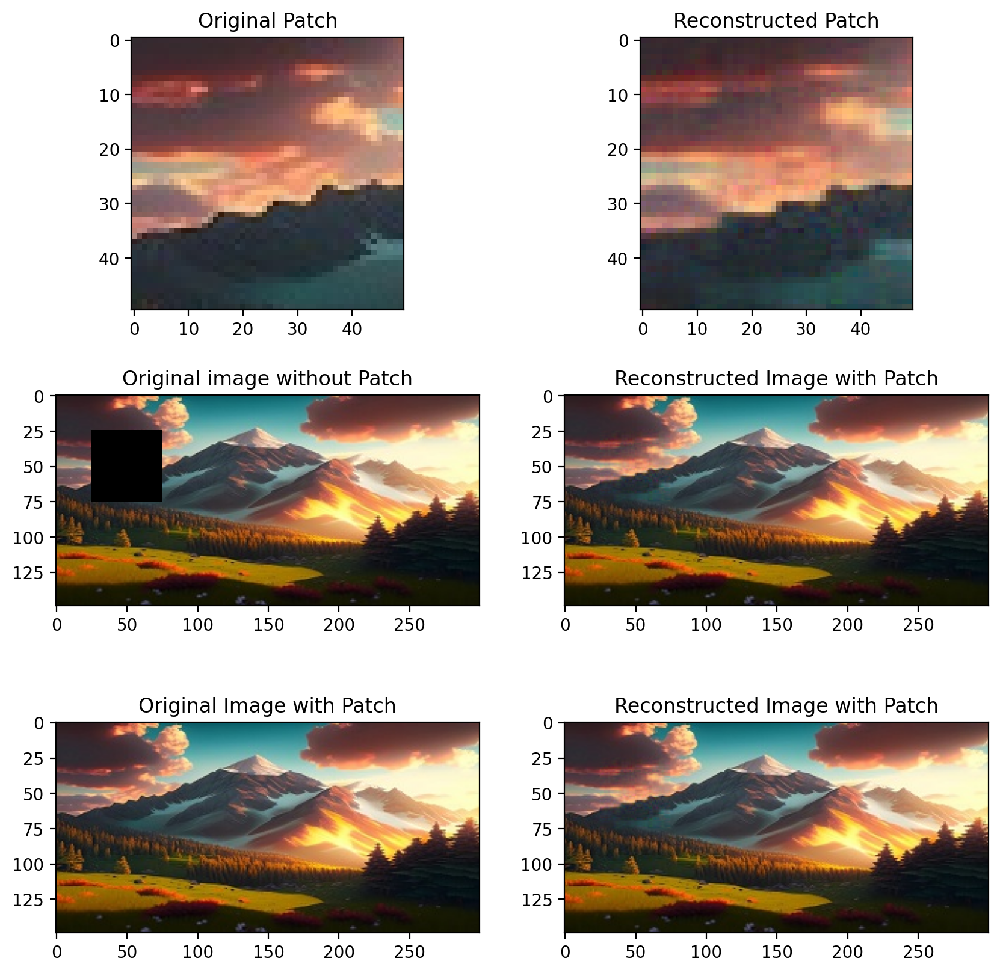

In [ ]:
img = torchvision.io.read_image("hill.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 25, 25, 50, 5)

torch.Size([149, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.03492488660616905
Peak Signal-to-Noise Ratio : 29.137299905503966


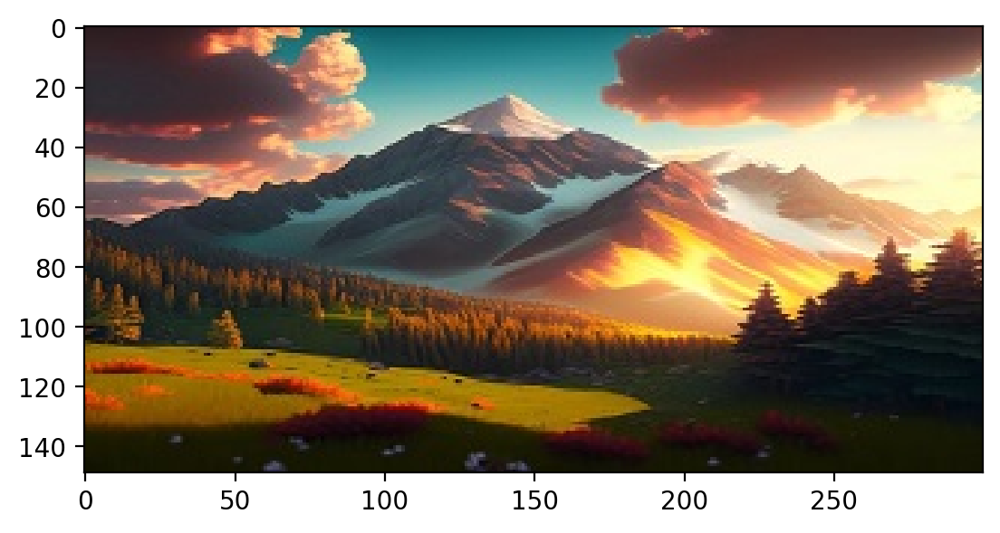

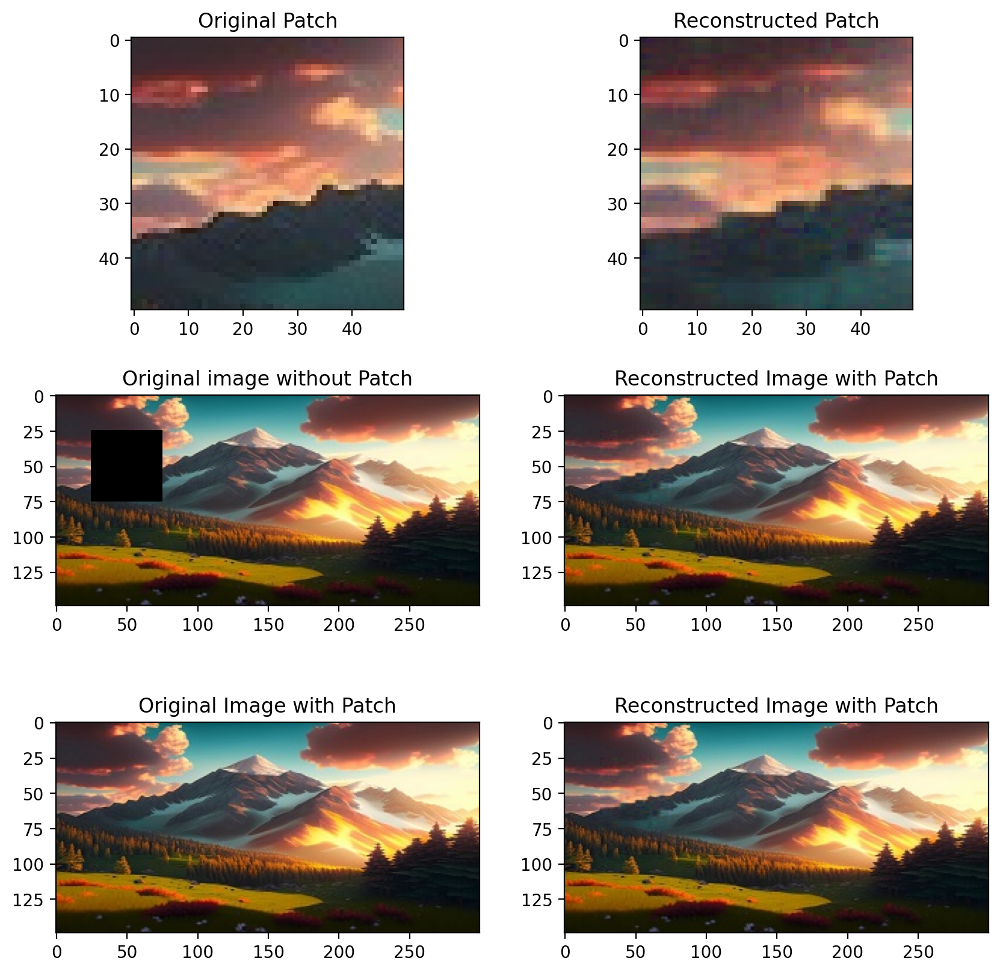

In [ ]:
img = torchvision.io.read_image("hill.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 25, 25, 50, 10)

torch.Size([149, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.0361999133529041
Peak Signal-to-Noise Ratio : 28.82584937961329


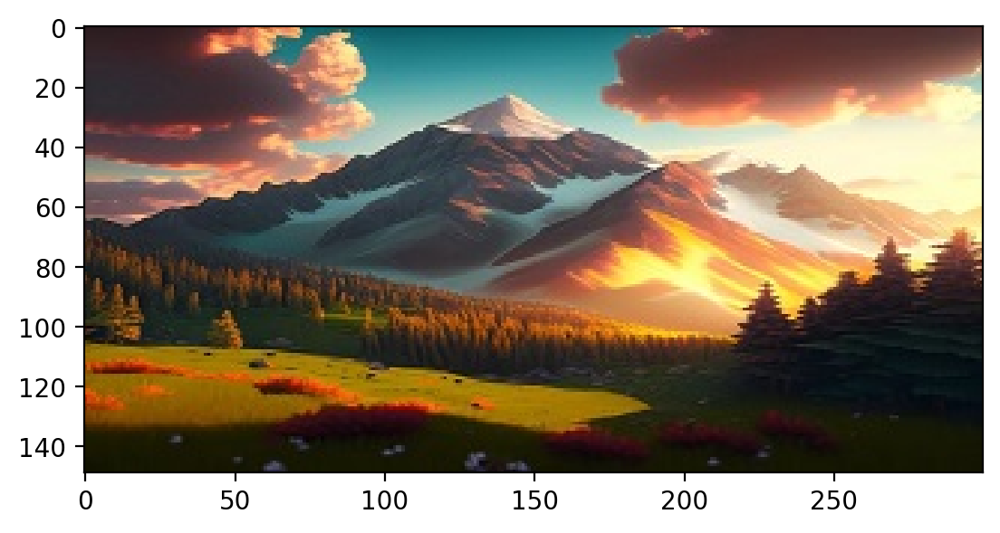

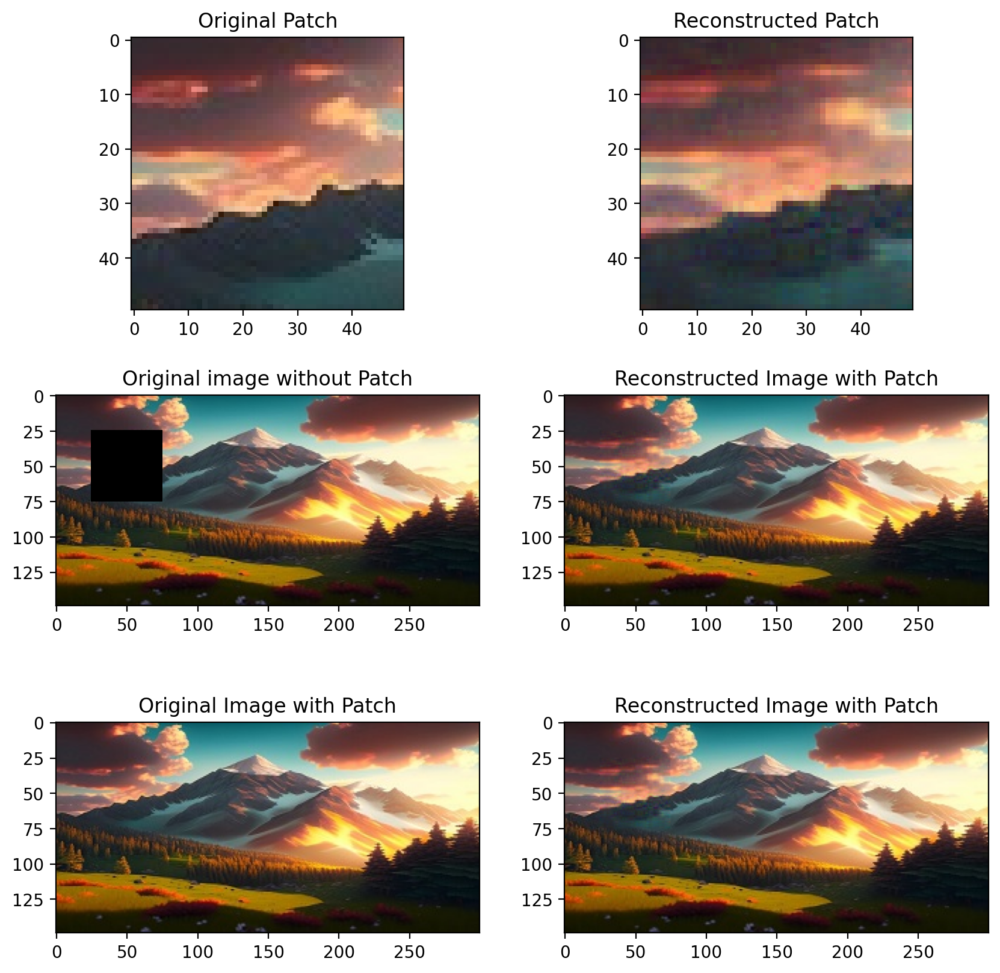

In [ ]:
img = torchvision.io.read_image("hill.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 25, 25, 50, 25)

torch.Size([149, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.03575810211015187
Peak Signal-to-Noise Ratio : 28.932510795823067


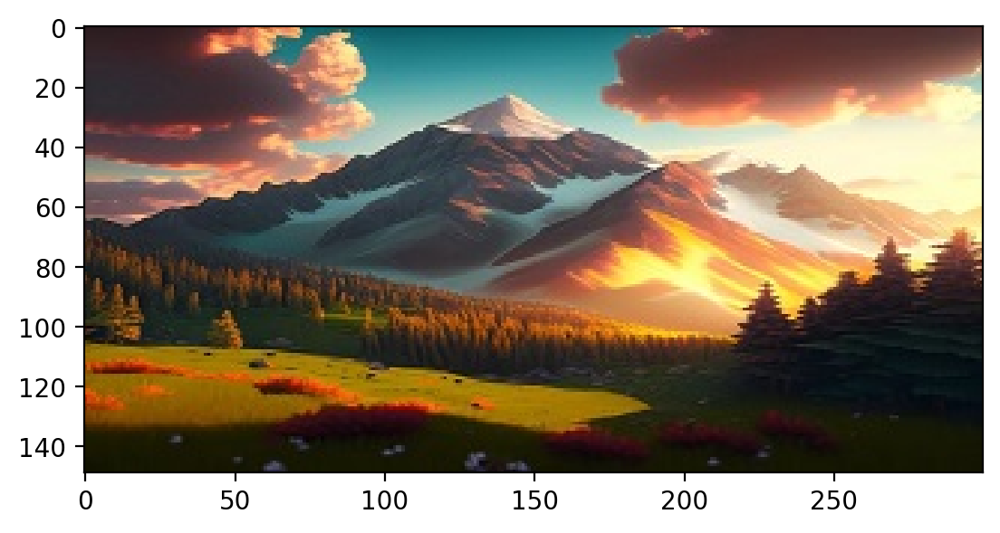

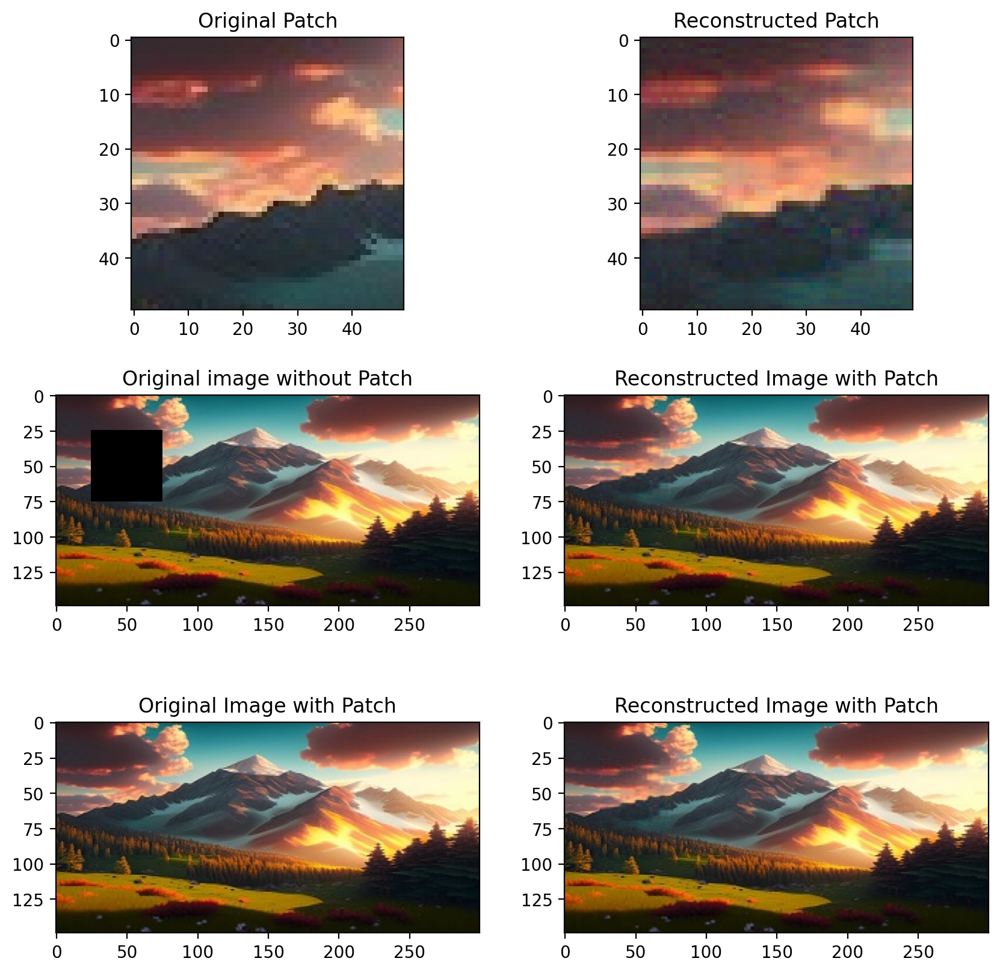

In [ ]:
img = torchvision.io.read_image("hill.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 25, 25, 50, 50)

torch.Size([249, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.0346184665899475
Peak Signal-to-Noise Ratio : 29.213843458428613


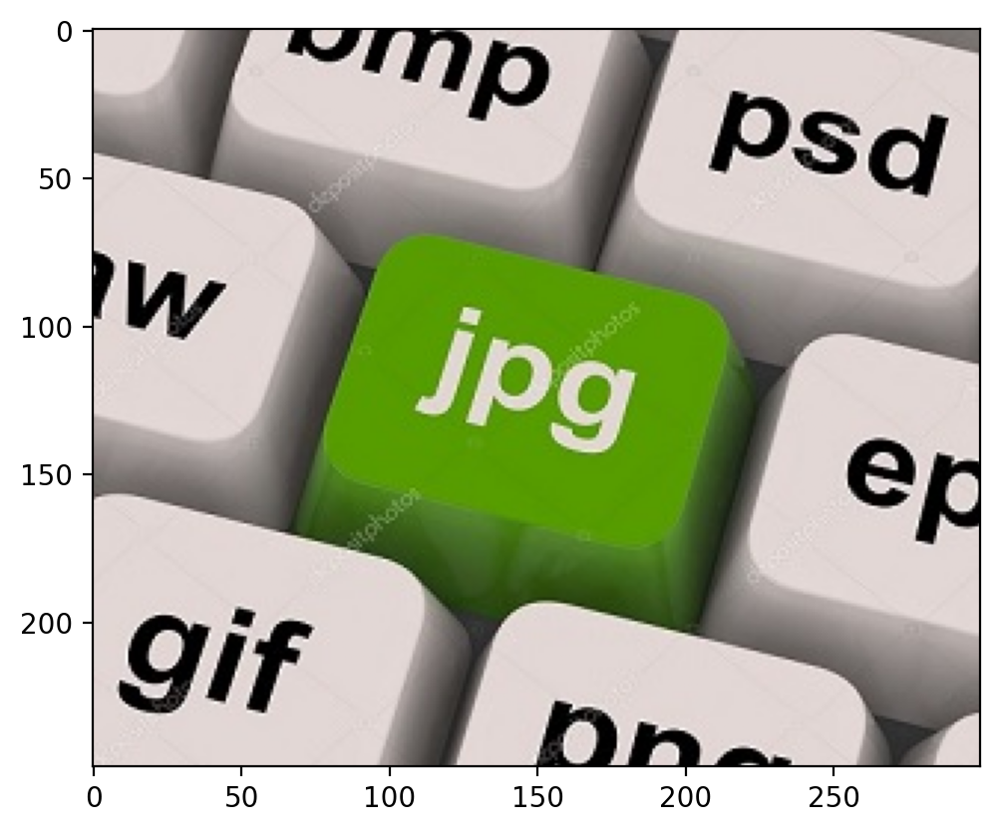

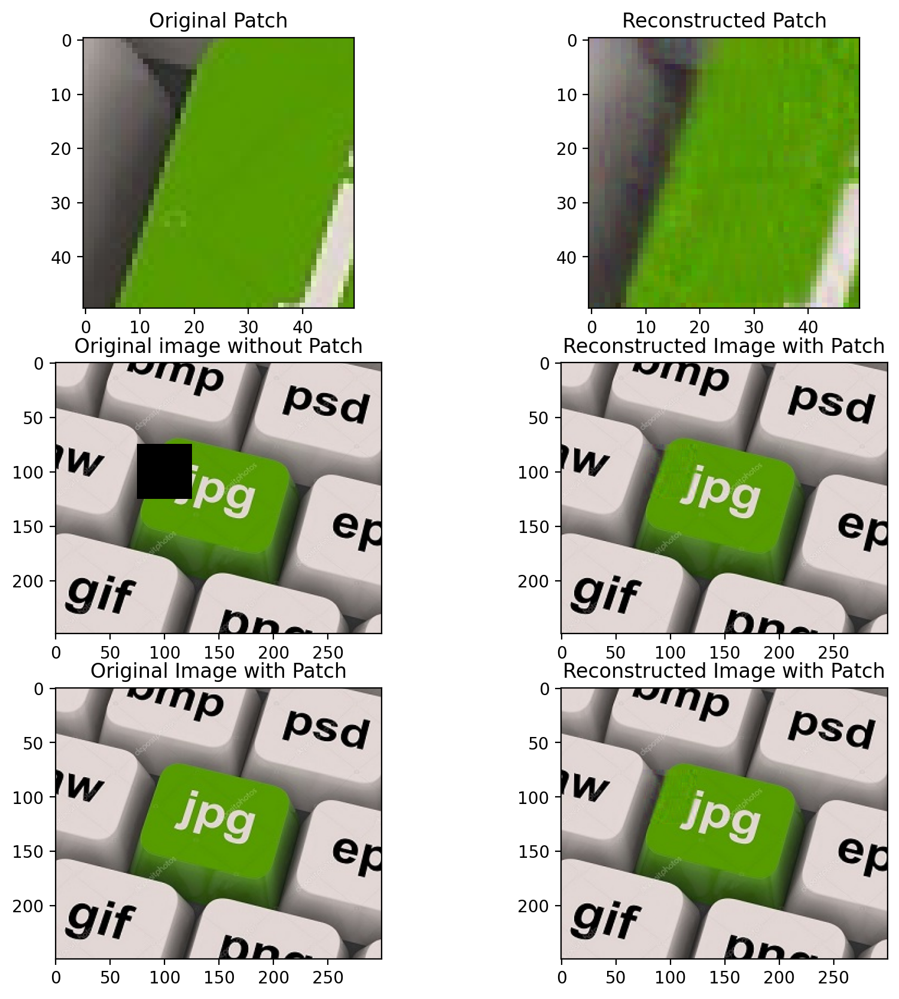

In [ ]:
img = torchvision.io.read_image("keys.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 75, 75, 50, 5)

torch.Size([249, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.03346469870346979
Peak Signal-to-Noise Ratio : 29.508261615516233


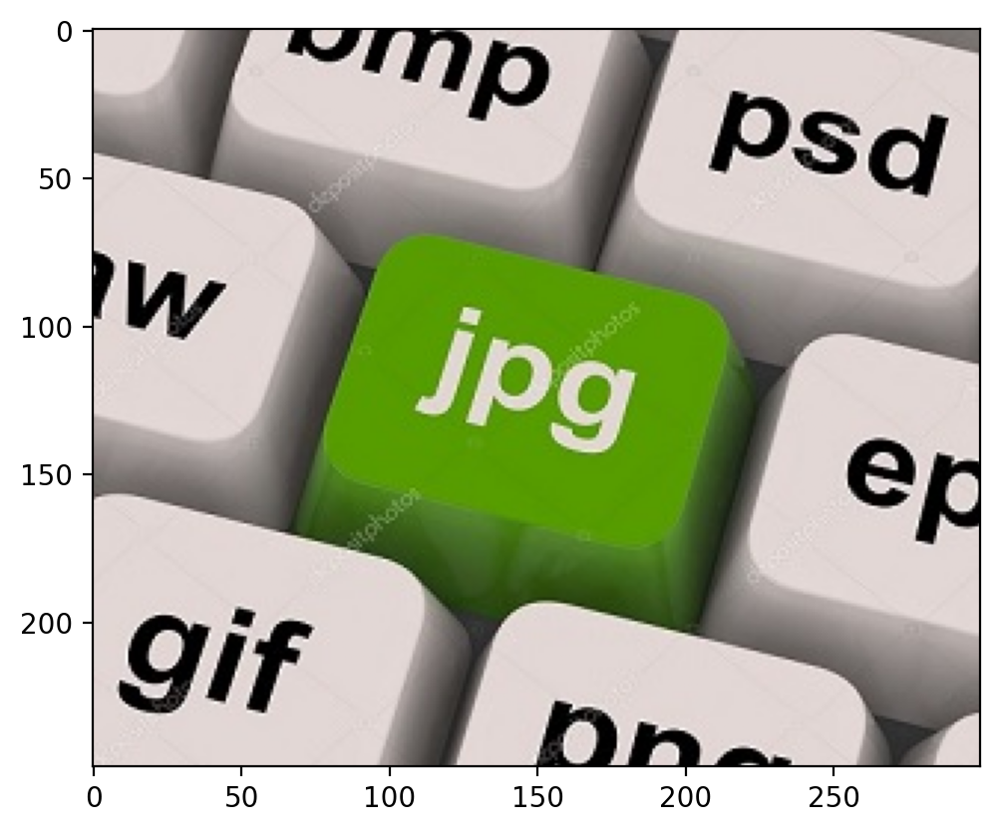

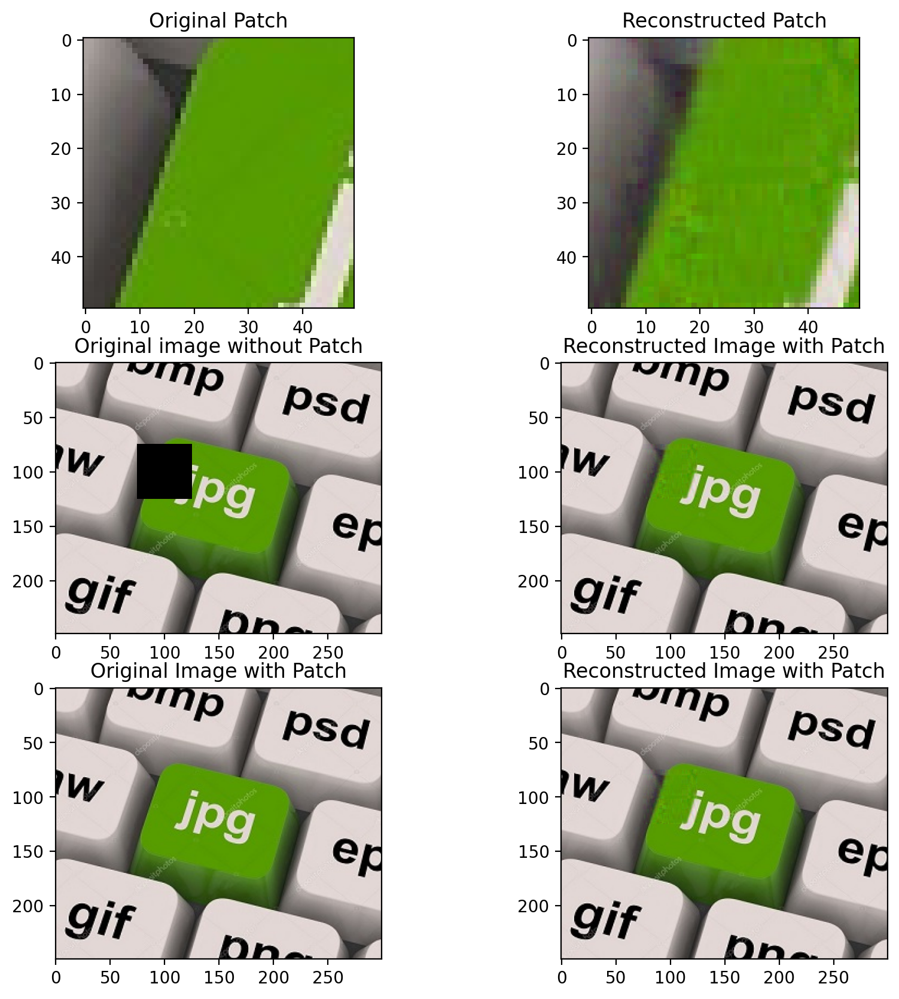

In [ ]:
img = torchvision.io.read_image("keys.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 75, 75, 50, 10)

torch.Size([249, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.03434221420540013
Peak Signal-to-Noise Ratio : 29.28343414495435


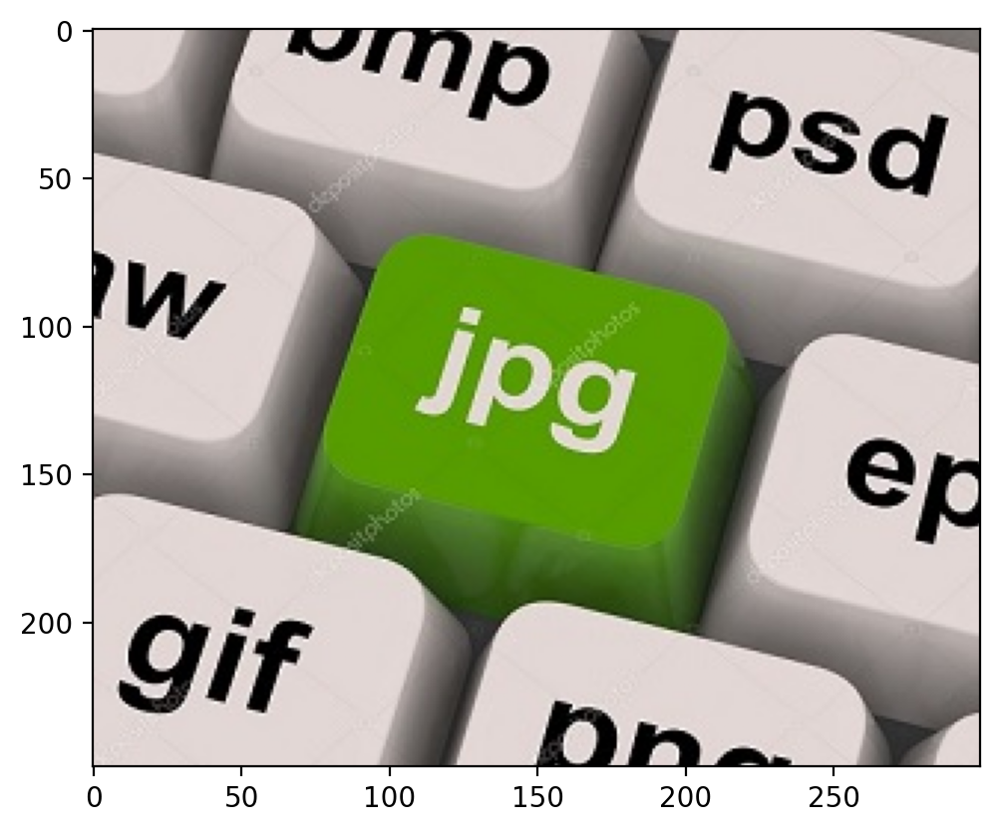

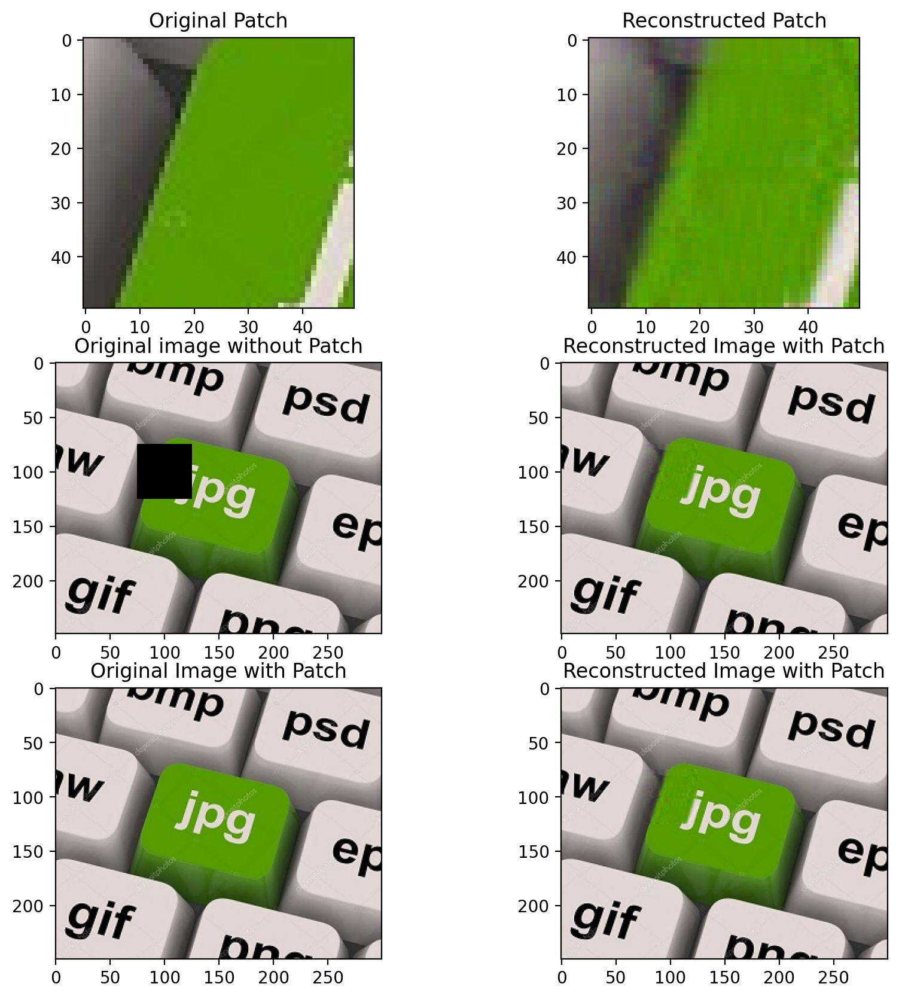

In [ ]:
img = torchvision.io.read_image("keys.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 75, 75, 50, 25)

torch.Size([249, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.03446475936793279
Peak Signal-to-Noise Ratio : 29.252494987843175


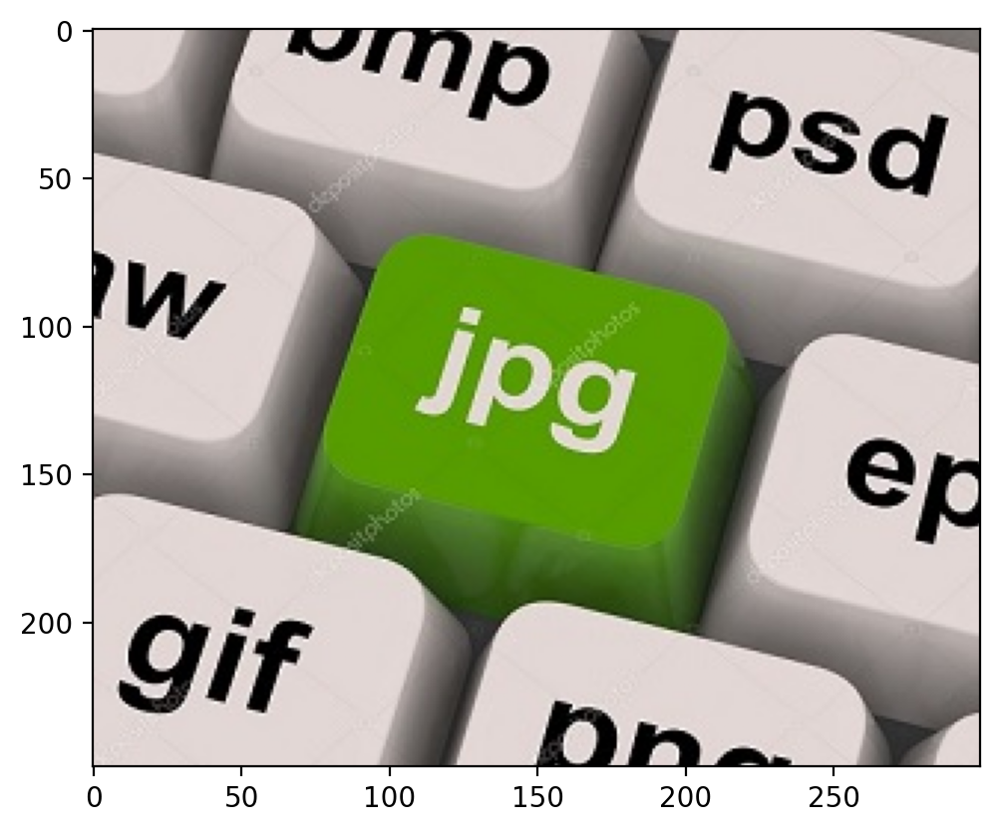

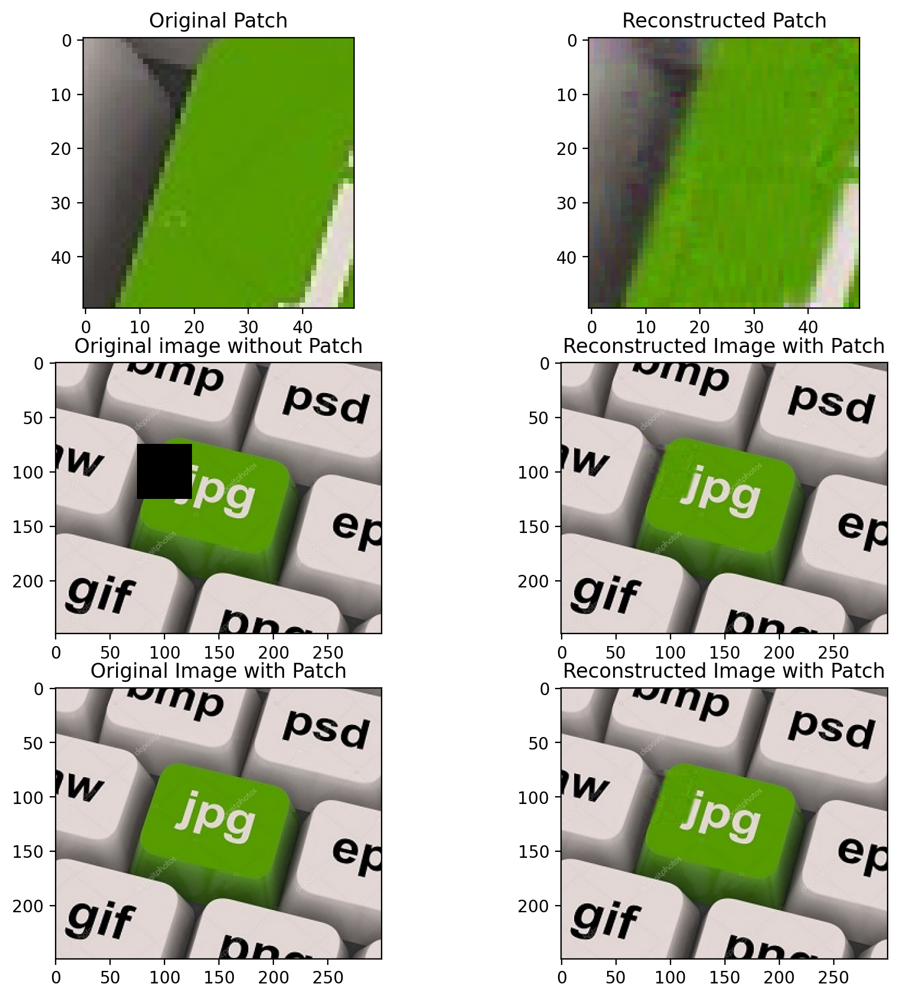

In [ ]:

img = torchvision.io.read_image("keys.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 75, 75, 50, 50)

torch.Size([168, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.061517626245733384
Peak Signal-to-Noise Ratio : 24.220008616365515


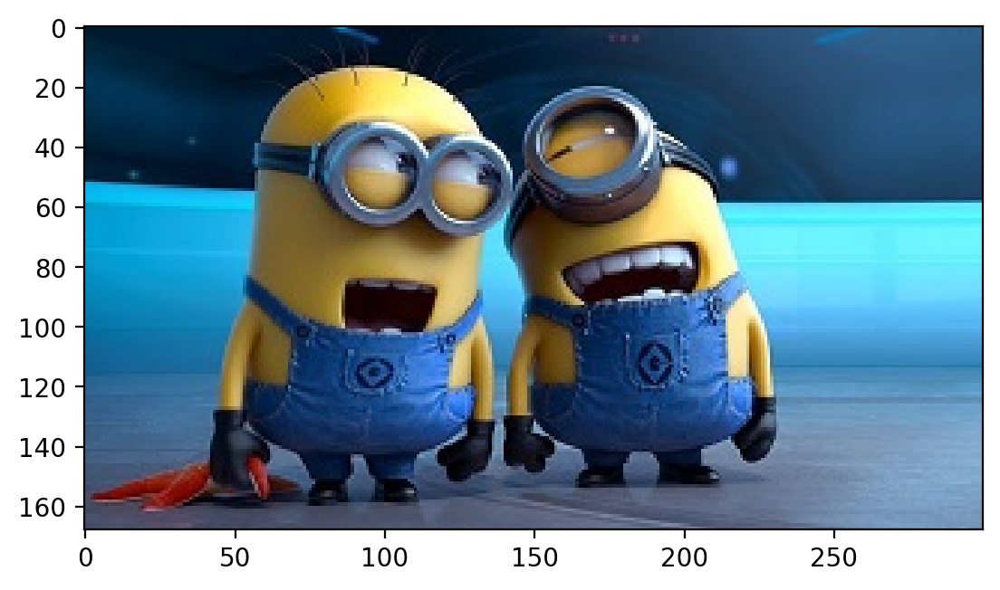

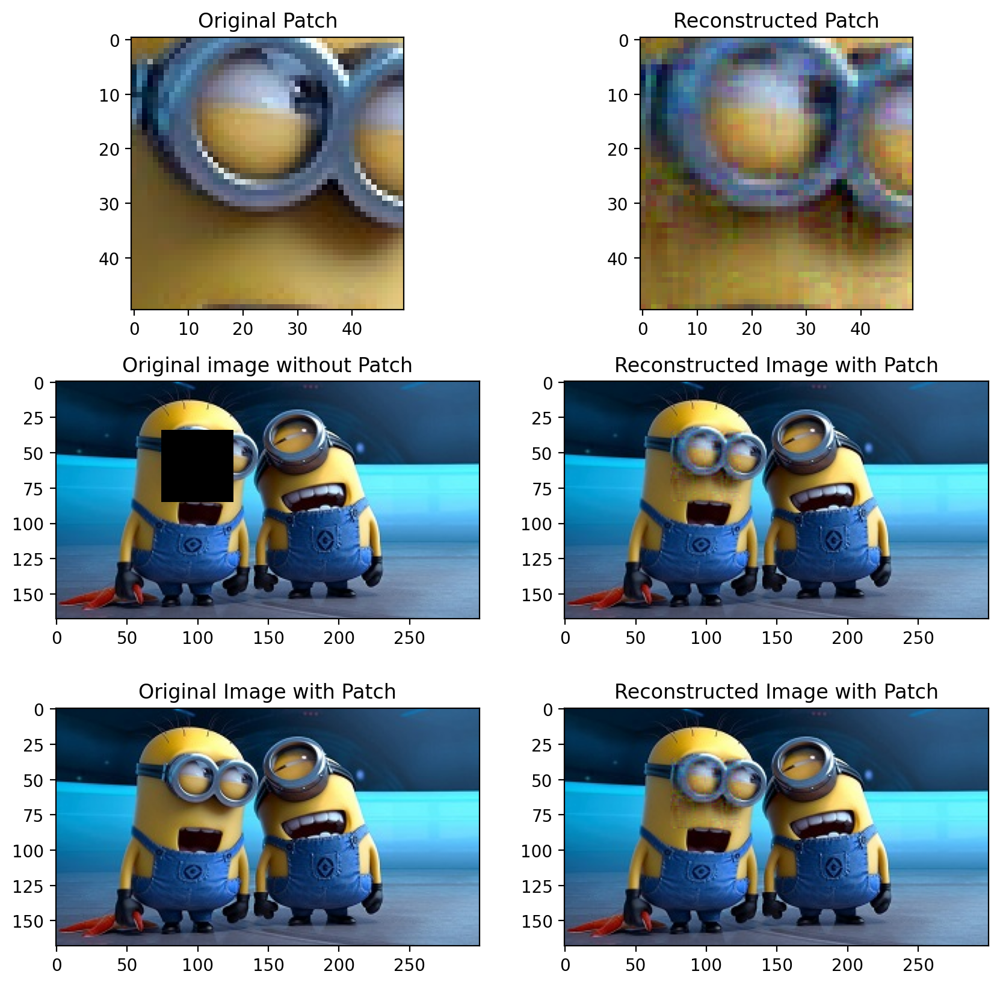

In [ ]:

img = torchvision.io.read_image("minions.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 35, 75, 50, 5)

torch.Size([168, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.0589647626797301
Peak Signal-to-Noise Ratio : 24.588148901219796


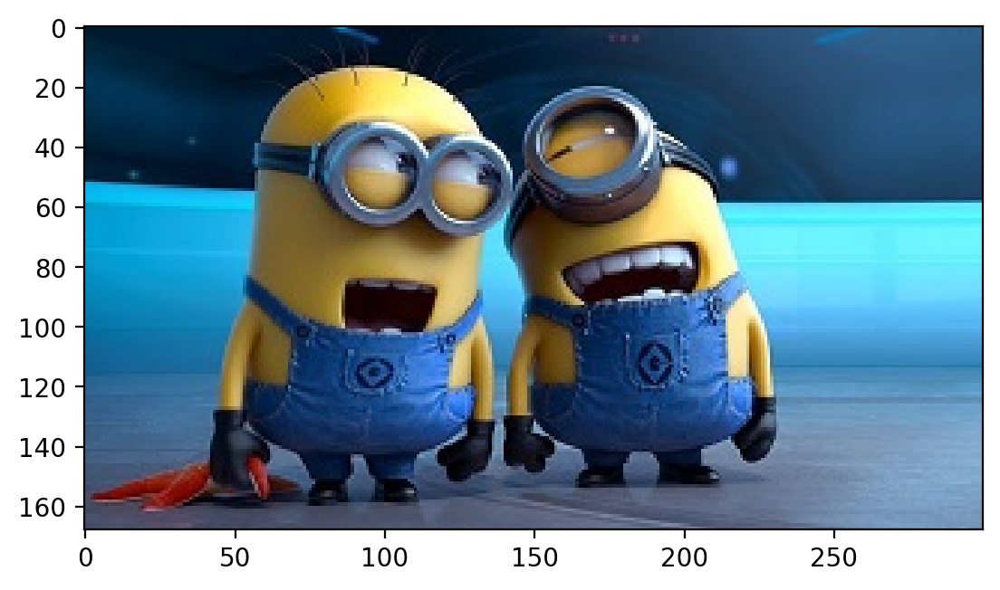

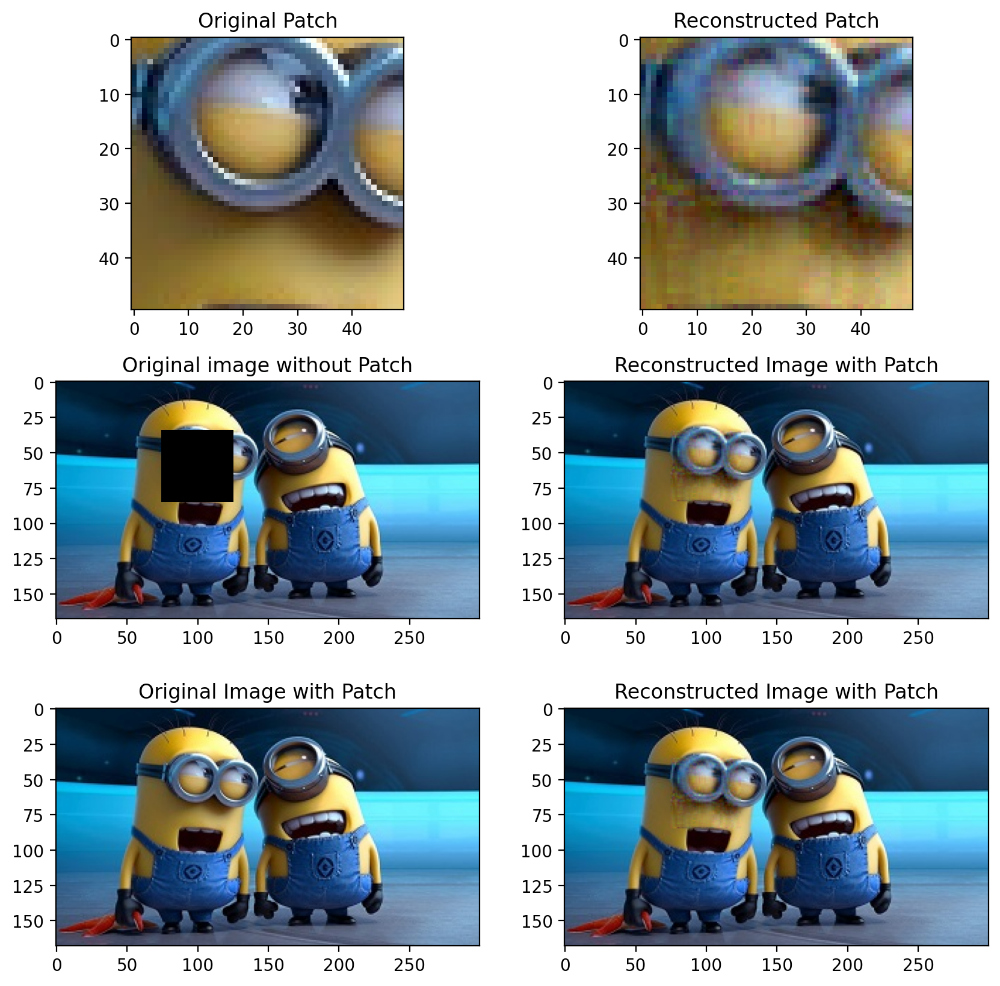

In [ ]:
img = torchvision.io.read_image("minions.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 35, 75, 50, 10)

torch.Size([168, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.061061401446499096
Peak Signal-to-Noise Ratio : 24.28466464486879


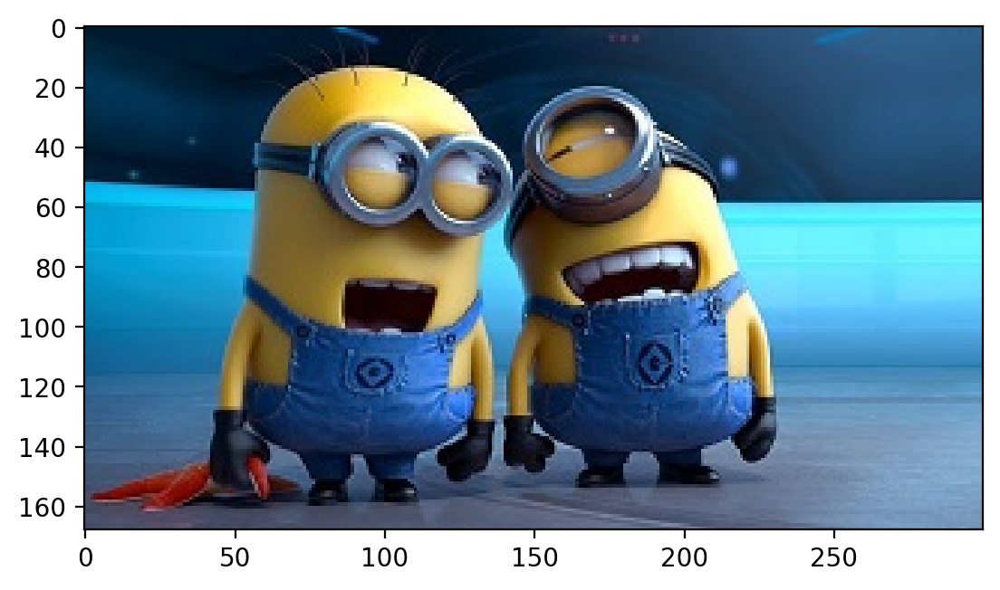

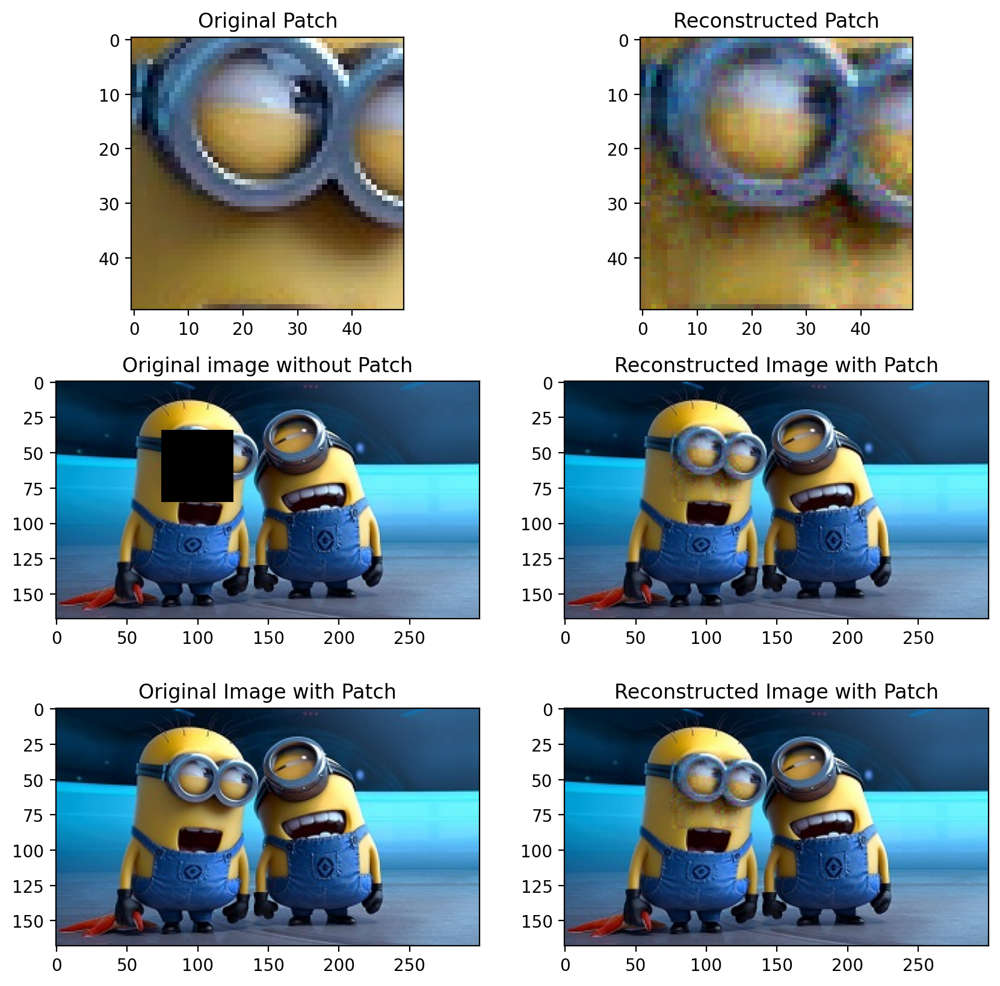

In [ ]:

img = torchvision.io.read_image("minions.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 35, 75, 50, 25)

torch.Size([168, 300, 3])


torch.Size([50, 50, 3])
root mean squared error : 0.06052801969174771
Peak Signal-to-Noise Ratio : 24.360870695221713


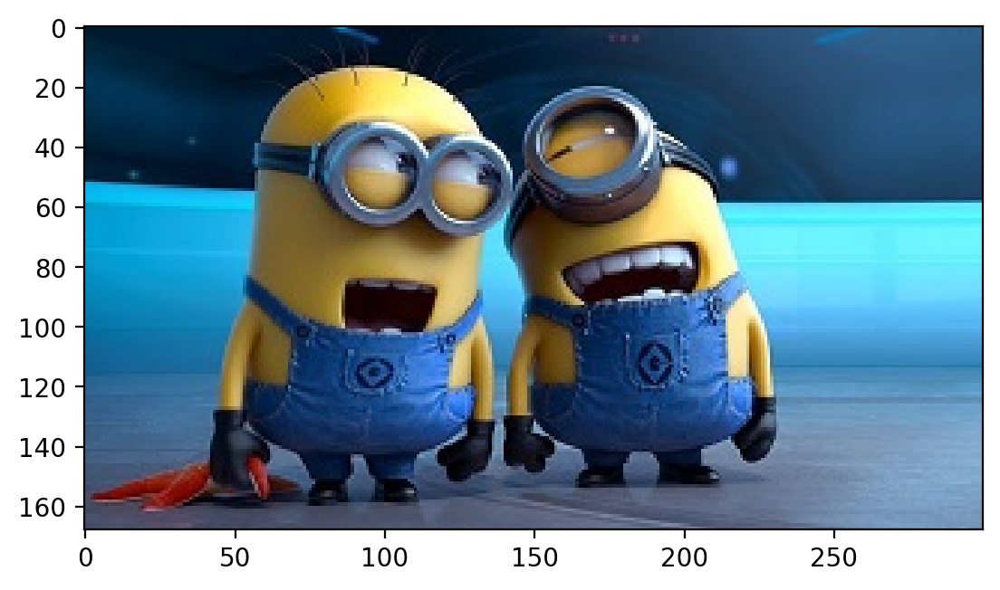

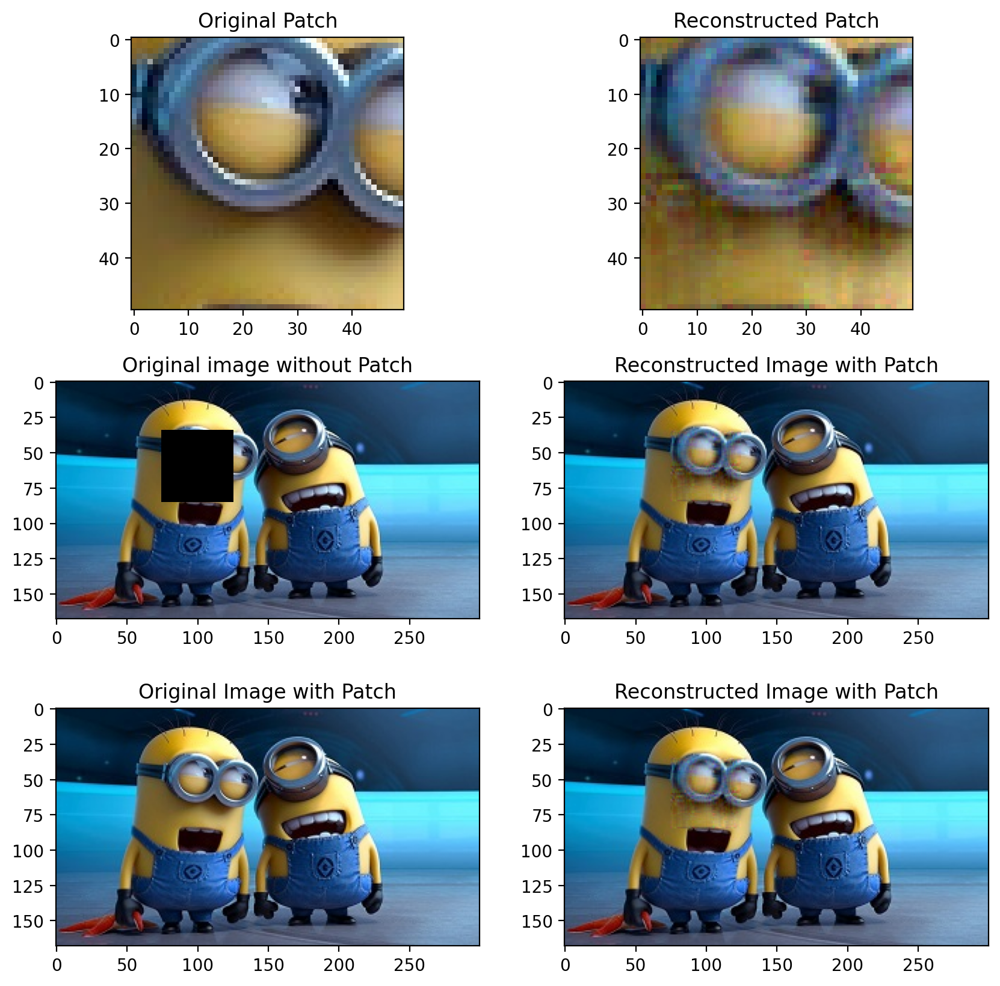

In [ ]:

img = torchvision.io.read_image("minions.jpg").float() / 255.0
img = img.permute(1, 2, 0)
print(img.shape)


plt.imshow(img)
reconstruct_patch(img, 35, 75, 50, 50)